# Voice conversion prototyping

with GMMs; VCTK corpus

Speakers p299 and p248

In [1]:
# open data
from os.path import join, expanduser
DATA_ROOT = join(expanduser("~"), "Documents/em_lct/UoM/thesis/data/", "VCTK-Corpus")
!ls $DATA_ROOT

COPYING          id-female        txt              wav48
README           speaker-info.txt us-female


In [2]:
# nnmnkwii imports taken from example notebook on VC
%pylab inline
rcParams["figure.figsize"] = (16,5)

from nnmnkwii.datasets import PaddedFileSourceDataset
from nnmnkwii.datasets.vctk import WavFileDataSource
from nnmnkwii.preprocessing.alignment import DTWAligner
from nnmnkwii.preprocessing import trim_zeros_frames, remove_zeros_frames, delta_features
from nnmnkwii.util import apply_each2d_trim
from nnmnkwii.metrics import melcd
from nnmnkwii.baseline.gmm import MLPG

from os import listdir
from os.path import basename, splitext, join, splitext, isdir
import sys
import time

import numpy as np
import pandas as pd
from scipy.io import wavfile
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
import pyworld
import pysptk
from pysptk.synthesis import MLSADF, Synthesizer
import librosa
import librosa.display
import IPython
from IPython.display import Audio

Populating the interactive namespace from numpy and matplotlib


In [3]:
fs = 48000
fftlen = pyworld.get_cheaptrick_fft_size(fs)
alpha = pysptk.util.mcepalpha(fs)
order = 24
frame_period = 5
hop_length = int(fs * (frame_period * 0.001))
max_files = 23 # number of utterances to be used.
test_size = 0.4
use_delta = True

if use_delta:
    windows = [
        (0, 0, np.array([1.0])),
        (1, 1, np.array([-0.5, 0.0, 0.5])),
        (1, 1, np.array([1.0, -2.0, 1.0])),
    ]
else:
    windows = [
        (0, 0, np.array([1.0])),
    ]

In [4]:
class MyFileDataSource(WavFileDataSource):
    def __init__(self, *args, **kwargs):
        super(MyFileDataSource, self).__init__(*args, **kwargs)
        self.test_paths = None

    def collect_files(self):
        paths = super(
            MyFileDataSource, self).collect_files()
        paths_train, paths_test = train_test_split(
            paths, test_size=test_size, random_state=False)

        # keep paths for later testing
        self.test_paths = paths_test

        return paths_train

    def collect_features(self, path):
        fs, x = wavfile.read(path)
        x = x.astype(np.float64)
        f0, timeaxis = pyworld.dio(x, fs, frame_period=frame_period)
        f0 = pyworld.stonemask(x, f0, timeaxis, fs)
        spectrogram = pyworld.cheaptrick(x, f0, timeaxis, fs)
        spectrogram = trim_zeros_frames(spectrogram)
        mc = pysptk.sp2mc(spectrogram, order=order, alpha=alpha)
        return mc

In [5]:
src_speaker = MyFileDataSource(data_root=DATA_ROOT, speakers=["299"], max_files=23)
tgt_speaker = MyFileDataSource(data_root=DATA_ROOT, speakers=["248"], max_files=23)

In [6]:
# convert training sets into arrays
X = PaddedFileSourceDataset(src_speaker, 2800).asarray()
Y = PaddedFileSourceDataset(tgt_speaker, 2800).asarray()
print(X.shape)
print(Y.shape) 
# shape = (13 training audios, 2800 frames, 25 features per frame)

(13, 2800, 25)
(13, 2800, 25)


In [7]:
src_speaker.test_paths

['/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_012.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_011.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_022.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_015.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_021.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_002.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_014.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_023.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_017.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p299/p299_009.wav']

In [8]:
tgt_speaker.test_paths

['/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_012.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_011.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_022.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_015.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_021.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_002.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_014.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_023.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_017.wav',
 '/Users/kennylino/Documents/em_lct/UoM/thesis/data/VCTK-Corpus/wav48/p248/p248_009.wav']

In [9]:
# Plotting util
def plot_parallel(x,y):
    figure(figsize=(16,7))
    subplot(2,1,1)
    librosa.display.specshow(trim_zeros_frames(x).T, sr=fs, hop_length=hop_length, x_axis="time")
    colorbar()
    subplot(2,1,2)
    librosa.display.specshow(trim_zeros_frames(y).T, sr=fs, hop_length=hop_length, x_axis="time")
    colorbar()

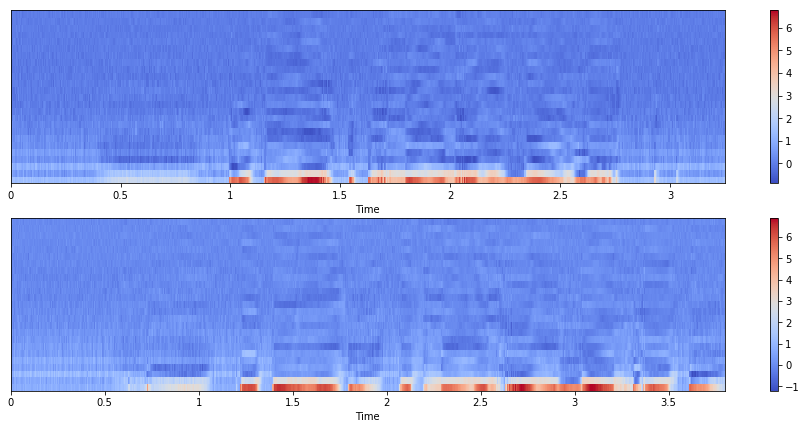

In [10]:
idx = 6 # any 
plot_parallel(X[idx],Y[idx])

In [11]:
# Alignment
X_aligned, Y_aligned = DTWAligner(verbose=0, dist=melcd).transform((X, Y))

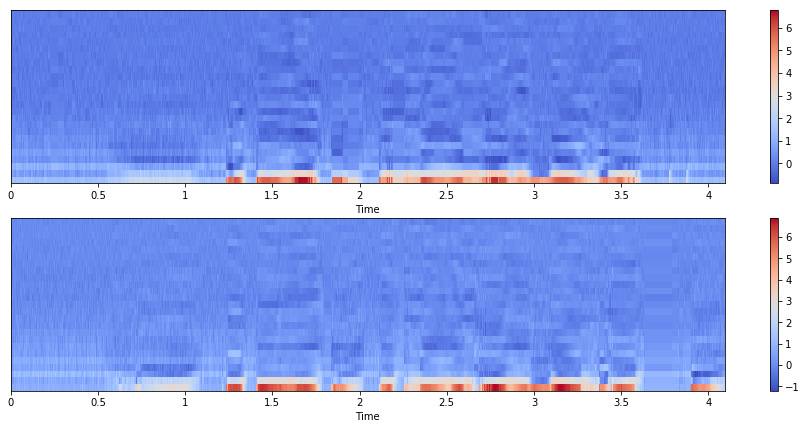

In [12]:
plot_parallel(X_aligned[idx],Y_aligned[idx])

In [13]:
# Drop 1st (power) dimension
X_aligned, Y_aligned = X_aligned[:, :, 1:], Y_aligned[:, :, 1:]

In [14]:
static_dim = X_aligned.shape[-1]
if use_delta:
    X_aligned = apply_each2d_trim(delta_features, X_aligned, windows)
    Y_aligned = apply_each2d_trim(delta_features, Y_aligned, windows)

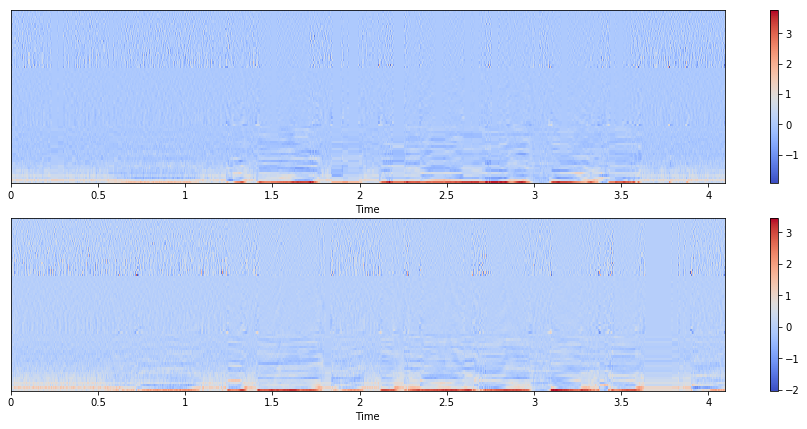

In [15]:
plot_parallel(X_aligned[idx],Y_aligned[idx])

## Kmeans clustering of MFCC feature vectors

In [16]:
km_X = KMeans(n_clusters=512, init='k-means++', max_iter=100, n_init=1)

In [17]:
X_aligned.shape

(13, 2800, 72)

In [18]:
# concatenates all of the frames in each sentence since k-means needs one large vector
all_frames_X = numpy.concatenate(X_aligned, axis=0)

In [19]:
# should equal number of frames * number of utterances
len(all_frames_X)

36400

In [20]:
all_frames_X.shape

(36400, 72)

In [21]:
all_frames_X[0]

array([ 1.03093970e+00,  6.46166146e-01,  2.52534300e-01,  4.08254594e-01,
        1.67297021e-01,  2.13377625e-01,  1.86640292e-01,  3.11216563e-02,
        1.42963026e-02, -9.33375995e-05,  2.23533958e-02,  4.31170911e-02,
       -9.84530970e-02, -1.26472535e-02,  1.57162808e-02, -3.63242161e-03,
       -1.09020837e-01,  4.63722507e-03,  1.57325957e-02, -5.32376580e-02,
        1.38118183e-02, -4.85138781e-03,  1.34539204e-02, -7.75551200e-02,
        2.47829854e-01,  5.82788706e-01,  4.02274251e-01,  4.26121324e-01,
        1.92455873e-01,  1.74489424e-01,  1.04217544e-01,  2.08187371e-01,
        1.06724180e-01,  6.69135004e-02, -6.75190315e-02, -1.06479466e-01,
        3.94710042e-02,  9.98662319e-03, -1.12363324e-01, -5.28330319e-02,
       -1.46910176e-02, -5.14580496e-02, -2.24423758e-03,  2.31811889e-02,
       -1.31958106e-03, -7.17404708e-02, -2.07725242e-02,  5.85901700e-02,
       -1.56621969e+00, -1.26754880e-01,  2.99479902e-01,  3.57334614e-02,
        5.03177047e-02, -

In [22]:
all_frames_X[19558]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0.])

In [23]:
# 0 frames are removed since they are all exactly the same
all_frames_X = remove_zeros_frames(all_frames_X)

In [24]:
len(all_frames_X)

19559

In [25]:
%time
km_X.fit(all_frames_X)

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 6.91 µs


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
    n_clusters=512, n_init=1, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [26]:
# help taken from: https://stackoverflow.com/questions/36195457/python-sklearn-kmeans-how-to-get-the-values-in-the-cluster
clustered_X = pd.DataFrame()
clustered_X['frame'] = all_frames_X.tolist()
clustered_X['cluster #'] = km_X.labels_

In [27]:
clustered_X.head()

,frame,cluster #
0,"[1.0309396982192993, 0.6461661458015442, 0.252...",109
1,"[0.4956597089767456, 1.1655774116516113, 0.804...",140
2,"[0.4844866991043091, 0.9188348650932312, 0.397...",433
3,"[0.4366951882839203, 0.9900461435317993, 0.042...",499
4,"[0.6139588356018066, 1.013366937637329, 0.5878...",273


In [28]:
cluster_dist_X = clustered_X.groupby('cluster #').size()

In [29]:
# use print(cluster_dist_X.to_string()) to see whole dist
print (cluster_dist_X.head)

<bound method NDFrame.head of cluster #
0       27
1       59
2       91
3       50
4       52
5       46
6       62
7       99
8       26
9       46
10      17
11      40
12      47
13      74
14      63
15      69
16      23
17      61
18      41
19      46
20     130
21      52
22      80
23      64
24      55
25      52
26      20
27     114
28       5
29      46
      ... 
482     29
483     19
484      8
485     70
486     19
487     39
488     44
489      1
490     11
491     24
492      2
493     28
494     18
495     69
496     21
497     34
498      3
499     33
500      2
501     10
502    120
503     50
504     27
505     13
506      3
507     22
508     26
509     26
510      9
511     26
Length: 512, dtype: int64>


In [30]:
cluster_dist_X.describe()

count    512.000000
mean      38.201172
std       28.327353
min        1.000000
25%       20.000000
50%       34.000000
75%       49.250000
max      237.000000
dtype: float64

### Clustering of the target speaker data

In [31]:
km_Y = KMeans(n_clusters=512, init='k-means++', max_iter=100, n_init=1)

In [32]:
# concatenates all of the frames in each sentence since k-means needs one large vector
all_frames_Y = numpy.concatenate(Y_aligned, axis=0)

In [33]:
# should equal number of frames * number of utterances
len(all_frames_Y)

36400

In [34]:
all_frames_Y.shape

(36400, 72)

In [35]:
test = all_frames_Y[0]

In [36]:
# 0 frames are removed since they are all exactly the same
all_frames_Y = remove_zeros_frames(all_frames_Y)

In [37]:
%time
km_Y.fit(all_frames_Y)

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 8.82 µs


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
    n_clusters=512, n_init=1, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [38]:
# help taken from: https://stackoverflow.com/questions/36195457/python-sklearn-kmeans-how-to-get-the-values-in-the-cluster
clustered_Y = pd.DataFrame()
clustered_Y['frame'] = all_frames_Y.tolist()
clustered_Y['cluster #'] = km_Y.labels_

In [39]:
clustered_Y.head()

,frame,cluster #
0,"[1.3293474912643433, 0.6128642559051514, 0.430...",220
1,"[0.801027238368988, 1.1139172315597534, 0.6928...",116
2,"[0.6510758996009827, 1.093887448310852, 0.7020...",249
3,"[0.6931142807006836, 1.2244385480880737, 0.357...",85
4,"[0.8790184259414673, 1.1366856098175049, 0.543...",451


In [40]:
cluster_dist_Y = clustered_Y.groupby('cluster #').size()

In [41]:
# use print(cluster_dist_Y.to_string()) to see whole dist
print (cluster_dist_Y.head)

<bound method NDFrame.head of cluster #
0      117
1       57
2       63
3       39
4       28
5       26
6       47
7       94
8       33
9       41
10     128
11      67
12      31
13      15
14      12
15      55
16      59
17      39
18      46
19       7
20      38
21      10
22      77
23      13
24      48
25      30
26      22
27      46
28      58
29      26
      ... 
482     16
483     37
484     30
485     52
486     21
487     49
488     38
489     45
490     47
491     30
492      2
493     23
494     54
495     79
496     13
497     50
498     35
499     45
500     26
501     52
502     23
503     19
504     34
505     31
506     21
507     41
508     48
509     38
510      1
511     19
Length: 512, dtype: int64>


In [42]:
cluster_dist_Y.describe()

count    512.000000
mean      38.201172
std       24.265100
min        1.000000
25%       21.000000
50%       34.000000
75%       52.000000
max      193.000000
dtype: float64

### Building the look-up table

In [43]:
%time
# shape = (13 training audios, 2800 frames, 25 features per frame)
# if using array as key doesn't work, use the string representation
# and convert the array into a string when looking it up in the dictionary


# all_frames_x contains each frame from each audio inside of X (aka X_aligned)

# the psuedocode for finding closest frames 
# for frame in all_frames_X:
#    predict the cluster of the frame in clustered_Y
#    find the closest data point in clustered_Y to frame
#    store X_frame and most similar frame, Y_frame in paired_frames_X

from scipy import spatial

# bytes version of X: array from Y
paired_frames_X = {}

for frame in all_frames_X:
    # needs to be reshaped to shape of km training data 
    frame_pred = frame.reshape(1, -1)
    predicted_cluster = km_Y.predict(frame_pred)[0] # returns cluster num
    # grabs the possible frames and converts them to the proper array format for KDTree
    possible_frames = (clustered_Y[clustered_Y['cluster #'] == predicted_cluster]['frame'].values).tolist()
    tree = spatial.KDTree(possible_frames)
    # tree.query() returns (the distance between the closest frame and index in series)
    most_similar = tree.query(frame)
    most_similar_vec = np.array(possible_frames[most_similar[1]]) # index in possible_frames
    frame_key = frame.tobytes() # converted to bytes since arrays cannot be keys
    paired_frames_X[frame_key] = most_similar_vec  

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 7.15 µs


In [44]:
%time
# shape = (13 training audios, 2800 frames, 25 features per frame)
# if using array as key doesn't work, use the string representation
# and convert the array into a string when looking it up in the dictionary


# all_frames_x contains each frame from each audio inside of X (aka X_aligned)

# the psuedocode for finding closest frames 
# for frame in all_frames_X:
#    predict the cluster of the frame in clustered_Y
#    find the closest data point in clustered_Y to frame
#    store X_frame and most similar frame, Y_frame in paired_frames_X

from scipy import spatial

# bytes version of Y: array from X
paired_frames_Y = {}

for frame in all_frames_Y:
    # needs to be reshaped to shape of km training data 
    frame_pred = frame.reshape(1, -1)
    predicted_cluster = km_X.predict(frame_pred)[0] # returns cluster num
    # grabs the possible frames and converts them to the proper array format for KDTree
    possible_frames = (clustered_X[clustered_X['cluster #'] == predicted_cluster]['frame'].values).tolist()
    tree = spatial.KDTree(possible_frames)
    # tree.query() returns (the distance between the closest frame and index in series)
    most_similar = tree.query(frame)
    most_similar_vec = np.array(possible_frames[most_similar[1]]) # index in possible_frames
    frame_key = frame.tobytes() # converted to bytes since arrays cannot be keys
    paired_frames_Y[frame_key] = most_similar_vec  

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 7.87 µs


In [45]:
# creates the 'most similar to X' array
Y = np.array([paired_frames_X[frame.tobytes()] for frame in all_frames_X])

In [46]:
# creates the 'most similar to X' array
X = np.array([paired_frames_Y[frame.tobytes()] for frame in all_frames_Y])

In [47]:
XY = np.concatenate((X, all_frames_Y), axis=-1)
print(XY.shape)

(19559, 144)


## GMM training

In [48]:
gmm = GaussianMixture(
    n_components=64, covariance_type="full", max_iter=100, verbose=1)

%time gmm.fit(XY)

Initialization 0
  Iteration 0
  Iteration 10
  Iteration 20
  Iteration 30
Initialization converged: True
CPU times: user 6min 9s, sys: 46.4 s, total: 6min 55s
Wall time: 3min 40s


GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
        means_init=None, n_components=64, n_init=1, precisions_init=None,
        random_state=None, reg_covar=1e-06, tol=0.001, verbose=1,
        verbose_interval=10, warm_start=False, weights_init=None)

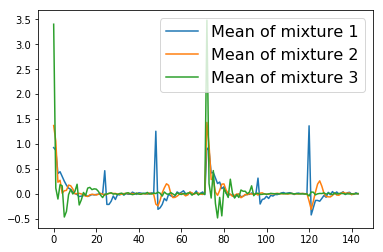

In [49]:
for k in range(3):
    plot(gmm.means_[k], linewidth=1.5, label="Mean of mixture {}".format(k+1))
legend(prop={"size": 16})

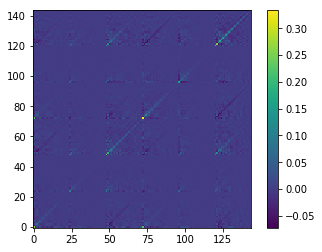

In [50]:
imshow(gmm.covariances_[0], origin="bottom left")
colorbar()

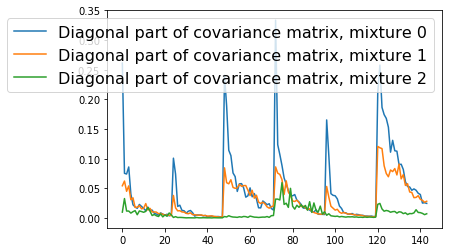

In [51]:
for k in range(3):
    plot(np.diag(gmm.covariances_[k]), linewidth=1.5, 
         label="Diagonal part of covariance matrix, mixture {}".format(k))
legend(prop={"size": 16})

In [52]:
def test_one_utt(src_path, tgt_path, disable_mlpg=False, diffvc=True):
    # GMM-based parameter generation is provided by the library in `baseline` module
    if disable_mlpg:
        # Force disable MLPG
        paramgen = MLPG(gmm, windows=[(0,0, np.array([1.0]))], diff=diffvc)
    else:
        paramgen = MLPG(gmm, windows=windows, diff=diffvc)

    fs, x = wavfile.read(src_path)
    x = x.astype(np.float64)
    f0, timeaxis = pyworld.dio(x, fs, frame_period=frame_period)
    f0 = pyworld.stonemask(x, f0, timeaxis, fs)
    spectrogram = pyworld.cheaptrick(x, f0, timeaxis, fs)
    aperiodicity = pyworld.d4c(x, f0, timeaxis, fs)

    mc = pysptk.sp2mc(spectrogram, order=order, alpha=alpha)
    c0, mc = mc[:, 0], mc[:, 1:]
    if use_delta:
        mc = delta_features(mc, windows)
    mc = paramgen.transform(mc)
    if disable_mlpg and mc.shape[-1] != static_dim:
        mc = mc[:,:static_dim]
    assert mc.shape[-1] == static_dim
    mc = np.hstack((c0[:, None], mc))
    if diffvc:
        mc[:, 0] = 0 # remove power coefficients
        engine = Synthesizer(MLSADF(order=order, alpha=alpha), hopsize=hop_length)
        b = pysptk.mc2b(mc.astype(np.float64), alpha=alpha)
        waveform = engine.synthesis(x, b)
    else:
        spectrogram = pysptk.mc2sp(
            mc.astype(np.float64), alpha=alpha, fftlen=fftlen)
        waveform = pyworld.synthesize(
            f0, spectrogram, aperiodicity, fs, frame_period)
        
    return waveform

In [ ]:
for i, (src_path, tgt_path) in enumerate(zip(src_speaker.test_paths, tgt_speaker.test_paths)):
    print("{}-th sample".format(i+1))
    wo_MLPG = test_one_utt(src_path, tgt_path, disable_mlpg=True)
    w_MLPG = test_one_utt(src_path, tgt_path, disable_mlpg=False)
    _, src = wavfile.read(src_path)
    _, tgt = wavfile.read(tgt_path)
    
    print("Source:", basename(src_path))
    IPython.display.display(Audio(src, rate=fs))
    print("Target:", basename(tgt_path))
    IPython.display.display(Audio(tgt, rate=fs))
    print("w/o MLPG")
    IPython.display.display(Audio(wo_MLPG, rate=fs))
    print("w/ MLPG")
    IPython.display.display(Audio(w_MLPG, rate=fs))

1-th sample
Source: p299_012.wav


Target: p248_012.wav


w/o MLPG


w/ MLPG


2-th sample
Source: p299_011.wav


Target: p248_011.wav


w/o MLPG


w/ MLPG


3-th sample
Source: p299_022.wav


Target: p248_022.wav


w/o MLPG


w/ MLPG


4-th sample
Source: p299_015.wav


Target: p248_015.wav


w/o MLPG


w/ MLPG


5-th sample
Source: p299_021.wav


Target: p248_021.wav


w/o MLPG


w/ MLPG


6-th sample
Source: p299_002.wav


Target: p248_002.wav


w/o MLPG


w/ MLPG


7-th sample
Source: p299_014.wav


Target: p248_014.wav


w/o MLPG


w/ MLPG


8-th sample
